# Challenge : predict conversion rates
In this project I will be trying to predict converison rates to a datascience newsletter. For this I will be testing several supervised machine learning models and chosing the best one. This model was then tested on unknown data for final evaluation.

## Import libraries

In [1]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, VotingClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import f1_score, confusion_matrix, classification_report


import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
# setting Jedha color palette as default
pio.templates["jedha"] = go.layout.Template(
    layout_colorway=["#4B9AC7", "#4BE8E0", "#9DD4F3", "#97FBF6", "#2A7FAF", "#23B1AB", "#0E3449", "#015955"]
)
pio.templates.default = "jedha"

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

## Read file with labels

In [2]:
data = pd.read_csv('conversion_data_train.csv')
print(data.shape)

(284580, 6)


In [3]:
print(data.head())

   country  age  new_user  source  total_pages_visited  converted
0    China   22         1  Direct                    2          0
1       UK   21         1     Ads                    3          0
2  Germany   20         0     Seo                   14          1
3       US   23         1     Seo                    3          0
4       US   28         1  Direct                    3          0


In [4]:
data.describe(include='all')

,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284580 entries, 0 to 284579
Data columns (total 6 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   country              284580 non-null  object
 1   age                  284580 non-null  int64 
 2   new_user             284580 non-null  int64 
 3   source               284580 non-null  object
 4   total_pages_visited  284580 non-null  int64 
 5   converted            284580 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 13.0+ MB


There is no missing data !

## EDA

A sample of the data will be used for EDA to facilitate graphics rendering

In [6]:
data_sample = data.sample(10000)

In [7]:
from plotly.subplots import make_subplots


fig = make_subplots(rows=2, cols=3, subplot_titles=('country', 'age', 'new_user', 'source', 'total_pages_visited','converted'))

fig.add_trace(go.Histogram(x=data.loc[:,'country']), row = 1, col = 1)
fig.add_trace(go.Histogram(x=data.loc[:,'age']), row = 1, col = 2)
fig.add_trace(go.Histogram(x=data.loc[:,'new_user']), row = 1, col = 3)
fig.add_trace(go.Histogram(x=data.loc[:,'source']), row = 2, col = 1)
fig.add_trace(go.Histogram(x=data.loc[:,'total_pages_visited']), row = 2, col = 2)
fig.add_trace(go.Histogram(x=data.loc[:,'converted']), row = 2, col = 3)

fig.update_layout(showlegend=False,
                  height = 600,
                  width = 1000)

fig.show()

Age and total pages visited have a poisson distribution. 

The US is much more respresented than the other countries

**Data is clearly unbalanced having many more zeros than one in 'converted'**

In [8]:
px.box(data,x='converted', y = 'age')

Some line have ages > 100 which is very unlikely, these observations have to be removed

The rest of the outlier are 'true' outliers, meaning they represent natural variations of the population. These will be kept.

In [9]:
px.box(data,x='converted', y = 'total_pages_visited')

We seem to have many outliers but then again I believe they are true outliers so I will be keeping them

In [10]:
px.scatter(data_sample, x='age', y='total_pages_visited', trendline='ols')

There seems to be a negative correlation between these two variables, an interation term between them might improve the model.

In [12]:
# Correlation matrix
corr_matrix = pd.DataFrame(data_sample).corr(numeric_only=True).round(2)

import plotly.figure_factory as ff

fig = ff.create_annotated_heatmap(corr_matrix.values,
                                  x = corr_matrix.columns.tolist(),
                                  y = corr_matrix.index.tolist())

fig.show()

The most correlated variable with our target 'converted' is total_pages_visited. This might indicate that this variable will contibute to the explanatory power in our model

In [13]:
data['country'].value_counts()

country
US         160124
China       69122
UK          43641
Germany     11693
Name: count, dtype: int64

Since UK and Germany have the lowest representation, I will be combining them into a new category = Europe. This might improve the Random Forest model

In [15]:
# remove age outliers
data = data[data['age'] < 100]

In [16]:
# Create a new Europe class containing UK and Germany 
data['country'] = data['country'].replace('UK', 'Europe')
data['country'] = data['country'].replace('Germany', 'Europe')

data['country'].value_counts()

country
US        160124
China      69122
Europe     55332
Name: count, dtype: int64

In [17]:
data = data.drop('source', axis=1)
data['age_page'] = data.apply(lambda x : x.age * x.total_pages_visited, axis=1)

In the cell above I am dropping the source feature, since in previous models it was not an important feature, and dropping it improved the overall score.

I also create a new column 'age_page' the interacction bewteen the age and total visited pages variables.

## Preprocessing

This preprocessing will be the same to all the models below: Random forest, Logistic regresion, Adaboosting with decision trees

- Normalizations of numeric variables

- One Hot encoder for categorical variables

- No imputation needed

In [18]:
target_variable = 'converted'

Split target and explanatory variables

In [19]:
X = data.drop(target_variable, axis=1)
Y = data.loc[:, target_variable]

print('Explanatory variables : ', X.columns)
print()

Explanatory variables :  Index(['country', 'age', 'new_user', 'total_pages_visited', 'age_page'], dtype='object')



Train test split

In [20]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0, stratify=Y)
print("...Done.")
print()

Dividing into train and test sets...
...Done.



## Training pipeline

In [21]:
# Manually define numerical and categorical features
numeric_features = ['age', 'total_pages_visited', 'age_page']
categorical_features = ['country', 'new_user']


In [22]:
# Define preprocessing pipeline
numeric_transformer = StandardScaler()

categorical_transformer = OneHotEncoder(drop='first')

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])


In [23]:
# Apply preprocessing
print("Preprocessing X_train...")
print(X_train.head())
print()
X_train = preprocessor.fit_transform(X_train)
print("...Done!")
print(X_train[0:5,:]) # X_train is now a numpy array
print()
print("Preprocessing X_test...")
print(X_test.head())
print()
X_test = preprocessor.fit_transform(X_test)
print("...Done!")
print(X_test[0:5,:]) # X_train is now a numpy array
print()

Preprocessing X_train...
       country  age  new_user  total_pages_visited  age_page
70238       US   23         0                    5       115
11738       US   26         1                    4       104
51223   Europe   39         1                    2        78
251695      US   39         1                    8       312
30005       US   44         1                    2        88

...Done!
[[-0.91614386  0.0376251  -0.3040312   0.          1.          0.        ]
 [-0.55333446 -0.2616379  -0.40588101  0.          1.          1.        ]
 [ 1.01883962 -0.86016391 -0.64661691  1.          0.          1.        ]
 [ 1.01883962  0.9354141   1.52000625  0.          1.          1.        ]
 [ 1.62352196 -0.86016391 -0.55402618  0.          1.          1.        ]]

Preprocessing X_test...
       country  age  new_user  total_pages_visited  age_page
138303  Europe   34         1                    1        34
133130  Europe   32         0                    5       160
245758      US 

# Random forest

I will be storing model scores into a new dataframe for easy comparisons

In [41]:
# create dataframe for score storage
scores_df = pd.DataFrame(columns = ['model', 'f1', 'set'])

Grid search for Random Forest model. Note that class_weights parameter is included for the Classifier since data is unbalanced. 

In [26]:
# Perform grid search for random forest
print("Grid search...")
classifier = RandomForestClassifier(class_weight={0:1,1:2})

# Grid of values to be tested
params = {
    'max_depth': [4, 6, 8, 10],
    'min_samples_leaf': [1, 2, 3],
    'min_samples_split': [2, 4, 6],
    'n_estimators': [10, 20, 40]
}
randforest = GridSearchCV(classifier, param_grid = params, cv = 3, n_jobs=-1, verbose=1, scoring='f1_macro')
randforest.fit(X_train, Y_train)
print("Best hyperparameters : ", randforest.best_params_)
print("...Done.")

Grid search...
Fitting 3 folds for each of 108 candidates, totalling 324 fits
Best hyperparameters :  {'max_depth': 8, 'min_samples_leaf': 3, 'min_samples_split': 6, 'n_estimators': 40}
...Done.


Predict on train and test datasets and retrieve f1 scores

In [42]:
# Predictions on train
print("Predictions on training set...")
Y_train_pred = randforest.predict(X_train)
print("...Done.")
print()

# Predictions on test
print("Predictions on test set...")
Y_test_pred = randforest.predict(X_test)
print("...Done.")
print()

# Store scores
scores_df = pd.concat([scores_df, pd.DataFrame.from_records([{'model': 'randforest', 'f1': f1_score(Y_train, Y_train_pred), 'set': 'train'}])])
scores_df = pd.concat([scores_df, pd.DataFrame.from_records([{'model': 'randforest', 'f1': f1_score(Y_test, Y_test_pred), 'set': 'test'}])])
print(scores_df)
print()

# Print confusion matrixes
print("Confusion matrix on train set : ")
print(confusion_matrix(Y_train, Y_train_pred))
print()
print("Confusion matrix on test set : ")
print(confusion_matrix(Y_test, Y_test_pred))
print()

print(classification_report(Y_test,Y_test_pred))

Predictions on training set...
...Done.

Predictions on test set...
...Done.

        model        f1    set
0  randforest  0.776226  train
0  randforest  0.758371   test

Confusion matrix on train set : 
[[218942   1378]
 [  1811   5531]]

Confusion matrix on test set : 
[[54691   389]
 [  477  1359]]

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     55080
           1       0.78      0.74      0.76      1836

    accuracy                           0.98     56916
   macro avg       0.88      0.87      0.88     56916
weighted avg       0.98      0.98      0.98     56916



F1-score is better for the class 0 than for the class 1. This is because therre are many more zeros in the target variable so it is easier for the model to guess them correctly.

The class weights do not represent the true imbalance of ones and zeros (which is about 30:1), however integrating these class weights increases recall but greatly diminishes precision. I will continue using a 1:2 class imbalance since it gives the best results.

# Logistic regression

In [40]:
# Perform grid search for logistic regression
print("Grid search...")
estimator = LogisticRegression(class_weight={0:1,1:2})
params = {
    'C': np.linspace(0.5, 1, 100, endpoint=False)
}
classifier = GridSearchCV(estimator, param_grid = params, cv = 3, n_jobs=-1, verbose=1, scoring='f1_macro')
classifier.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", classifier.best_params_)

Grid search...
Fitting 3 folds for each of 100 candidates, totalling 300 fits


...Done.
Best hyperparameters :  {'C': 0.5}


In [43]:
print("Predictions on training set...")
Y_train_pred = classifier.predict(X_train)
print("...Done.")
print()

print("Predictions on test set...")
Y_test_pred = classifier.predict(X_test)
print("...Done.")
print()

scores_df = pd.concat([scores_df, pd.DataFrame.from_records([{'model': 'logistic', 'f1': f1_score(Y_train, Y_train_pred), 'set': 'train'}])])
scores_df = pd.concat([scores_df, pd.DataFrame.from_records([{'model': 'logistic', 'f1': f1_score(Y_test, Y_test_pred), 'set': 'test'}])])
print(scores_df)
print()

print("Confusion matrix on train set : ")
print(confusion_matrix(Y_train, Y_train_pred))
print()
print("Confusion matrix on test set : ")
print(confusion_matrix(Y_test, Y_test_pred))
print()

print(classification_report(Y_test,Y_test_pred))

Predictions on training set...
...Done.

Predictions on test set...
...Done.

        model        f1    set
0  randforest  0.776226  train
0  randforest  0.758371   test
0    logistic  0.768726  train
0    logistic  0.760208   test

Confusion matrix on train set : 
[[218662   1658]
 [  1723   5619]]

Confusion matrix on test set : 
[[54654   426]
 [  449  1387]]

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     55080
           1       0.77      0.76      0.76      1836

    accuracy                           0.98     56916
   macro avg       0.88      0.87      0.88     56916
weighted avg       0.98      0.98      0.98     56916



# Adaboost decision tree

In [44]:
# Perform grid search for adaboost decision tree
print("Grid search...")
decision_tree = DecisionTreeClassifier(class_weight={0:1,1:2})
model = AdaBoostClassifier(decision_tree)

# Grid of values to be tested
params = {
    'base_estimator__max_depth': [4, 6, 8, 10],
    'base_estimator__min_samples_leaf': [1, 2, 5, 6],
    'base_estimator__min_samples_split': [2, 4, 8],
    'n_estimators': [2, 4, 6, 8]
}
print(params)
adaboostdt = GridSearchCV(model, param_grid = params, cv = 3, n_jobs=-1, verbose=1, scoring='f1_macro')
adaboostdt.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", adaboostdt.best_params_)

Grid search...
{'base_estimator__max_depth': [4, 6, 8, 10], 'base_estimator__min_samples_leaf': [1, 2, 5, 6], 'base_estimator__min_samples_split': [2, 4, 8], 'n_estimators': [2, 4, 6, 8]}
Fitting 3 folds for each of 192 candidates, totalling 576 fits


/home/nicolasleurs/miniconda3/envs/machinelearning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:720: FutureWarning: Parameter 'base_estimator' of AdaBoostClassifier is deprecated in favor of 'estimator'. See AdaBoostClassifier's docstring for more details.
  estimator = estimator.set_params(**cloned_parameters)
/home/nicolasleurs/miniconda3/envs/machinelearning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:720: FutureWarning: Parameter 'base_estimator' of AdaBoostClassifier is deprecated in favor of 'estimator'. See AdaBoostClassifier's docstring for more details.
  estimator = estimator.set_params(**cloned_parameters)
/home/nicolasleurs/miniconda3/envs/machinelearning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:720: FutureWarning: Parameter 'base_estimator' of AdaBoostClassifier is deprecated in favor of 'estimator'. See AdaBoostClassifier's docstring for more details.
  estimator = estimator.set_params(**cloned_para

...Done.
Best hyperparameters :  {'base_estimator__max_depth': 4, 'base_estimator__min_samples_leaf': 6, 'base_estimator__min_samples_split': 2, 'n_estimators': 6}


In [46]:
print("Predictions on training set...")
Y_train_pred = adaboostdt.predict(X_train)
print("...Done.")
print()

print("Predictions on test set...")
Y_test_pred = adaboostdt.predict(X_test)
print("...Done.")
print()

scores_df = pd.concat([scores_df, pd.DataFrame.from_records([{'model': 'adaboostdt', 'f1': f1_score(Y_train, Y_train_pred), 'set': 'train'}])])
scores_df = pd.concat([scores_df, pd.DataFrame.from_records([{'model': 'adaboostdt', 'f1': f1_score(Y_test, Y_test_pred), 'set': 'test'}])])
print(scores_df)
print()

print("Confusion matrix on train set : ")
print(confusion_matrix(Y_train, Y_train_pred))
print()
print("Confusion matrix on test set : ")
print(confusion_matrix(Y_test, Y_test_pred))
print()

print(classification_report(Y_test,Y_test_pred))

Predictions on training set...
...Done.

Predictions on test set...
...Done.

        model        f1    set
0  randforest  0.776226  train
0  randforest  0.758371   test
0    logistic  0.768726  train
0    logistic  0.760208   test
0  adaboostdt  0.764746  train
0  adaboostdt  0.755409   test

Confusion matrix on train set : 
[[218657   1663]
 [  1767   5575]]

Confusion matrix on test set : 
[[54644   436]
 [  457  1379]]

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     55080
           1       0.76      0.75      0.76      1836

    accuracy                           0.98     56916
   macro avg       0.88      0.87      0.87     56916
weighted avg       0.98      0.98      0.98     56916



For now the models are quite close in terms of f1-scores. However the logistic regression is the one with the least overfitting !

# Voting

In the cell below I redefine my estimators with the optimized hyperparameters and feed them into a voting classifier

In [49]:
rf = RandomForestClassifier(class_weight={0:1,1:2}, max_depth=8, min_samples_leaf=3, min_samples_split=6, n_estimators=40)
lr = LogisticRegression(class_weight={0:1,1:2}, C= 0.5)
dt = DecisionTreeClassifier(class_weight={0:1,1:2}, max_depth=4, min_samples_leaf=6, min_samples_split=2)
abdt = AdaBoostClassifier(dt, n_estimators=6)

voting = VotingClassifier(estimators=[("logistic", lr), ("random_forest", rf), ("adaboost", abdt)], voting='soft')
voting.fit(X_train, Y_train)
print("...Done.")

...Done.


In [50]:
print("Predictions on training set...")
Y_train_pred = voting.predict(X_train)
print("...Done.")
print()

print("Predictions on test set...")
Y_test_pred = voting.predict(X_test)
print("...Done.")
print()

scores_df = pd.concat([scores_df, pd.DataFrame.from_records([{'model': 'voting', 'f1': f1_score(Y_train, Y_train_pred), 'set': 'train'}])])
scores_df = pd.concat([scores_df, pd.DataFrame.from_records([{'model': 'voting', 'f1': f1_score(Y_test, Y_test_pred), 'set': 'test'}])])
print(scores_df)
print()

print("Confusion matrix on train set : ")
print(confusion_matrix(Y_train, Y_train_pred))
print()
print("Confusion matrix on test set : ")
print(confusion_matrix(Y_test, Y_test_pred))
print()

print(classification_report(Y_test,Y_test_pred))

Predictions on training set...
...Done.

Predictions on test set...
...Done.

        model        f1    set
0  randforest  0.776226  train
0  randforest  0.758371   test
0    logistic  0.768726  train
0    logistic  0.760208   test
0  adaboostdt  0.764746  train
0  adaboostdt  0.755409   test
0      voting  0.773459  train
0      voting  0.760954   test

Confusion matrix on train set : 
[[218826   1494]
 [  1770   5572]]

Confusion matrix on test set : 
[[54682   398]
 [  464  1372]]

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     55080
           1       0.78      0.75      0.76      1836

    accuracy                           0.98     56916
   macro avg       0.88      0.87      0.88     56916
weighted avg       0.98      0.98      0.98     56916



In [51]:
print('Voting train F1-score : ', f1_score(Y_train, Y_train_pred))
print('Voting test F1-score : ', f1_score(Y_test, Y_test_pred))

scores = cross_val_score(voting, X_train, Y_train, cv=5, scoring="f1")
print('The cross-validated F1-score is : ', scores.mean())
print('The standard deviation is : ', scores.std())

Voting train F1-score :  0.773459189339256
Voting test F1-score :  0.7609539656128675
The cross-validated F1-score is :  0.7692072470355852
The standard deviation is :  0.011297434827647286


It seems the model is not overfitting ! So although the logistic regression scores are closer to each other, the voting model is very good as well.

In [52]:
scores_df = scores_df.sort_values(by = ['set', 'f1'], ascending = False)
fig = px.bar(scores_df, x = "model", y = 'f1', color = 'set', barmode = 'group', width = 900)
fig.update_layout(yaxis_range=[0.75,0.78])

We can see that the voting classifier perform better than the other models on their own. 

In this graph the overitting seems to be flagrant but it is an artifact of the zoom specified to better visualize model differences.

## Train best classifier on all data and use it to make predictions on X_without_labels
**Before making predictions on the file conversion_data_test.csv, let's train our model on ALL the data that was in conversion_data_train.csv. Sometimes, this allows to make tiny improvements in the score because we're using more examples to train the model.**

In [57]:
# Concatenate our train and test set to train your best classifier on all data with labels
X = np.append(X_train,X_test,axis=0)
Y = np.append(Y_train,Y_test)

voting.fit(X,Y)
lr.fit(X,Y)
print('Done !')

Done !


In [58]:
data_without_labels = pd.read_csv('conversion_data_test.csv')
print('Prediction set (without labels) :', data_without_labels.shape)

data_without_labels = data_without_labels.drop('source', axis=1)
data_without_labels['age_page'] = data_without_labels.apply(lambda x : x.age * x.total_pages_visited, axis=1)
data_without_labels['country'] = data_without_labels['country'].replace('UK', 'Europe')
data_without_labels['country'] = data_without_labels['country'].replace('Germany', 'Europe')
data_without_labels.head()

features_list = ['age', 'total_pages_visited', 'age_page','country', 'new_user']
X_without_labels = data_without_labels.loc[:, features_list]


Prediction set (without labels) : (31620, 5)


In [59]:
print("Encoding categorical features and standardizing numerical features...")

X_without_labels = preprocessor.transform(X_without_labels)
print("...Done")
print(X_without_labels[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[-0.30528106  3.32918768  2.8121749   1.          0.          0.        ]
 [-1.03320305  0.03921217 -0.34649997  1.          0.          1.        ]
 [ 0.18000027 -1.15714256 -1.07542494  0.          0.          1.        ]
 [ 0.18000027  0.33830085  0.41980577  0.          1.          1.        ]
 [-0.66924205 -0.5589652  -0.67358168  0.          0.          0.        ]]


In [60]:
data = {
    'converted': voting.predict(X_without_labels)
}

Y_predictions = pd.DataFrame(columns=['converted'],data=data)
Y_predictions.to_csv('conversion_data_test_predictions_LEURS-model.csv', index=False)


In [61]:
data = {
    'converted': lr.predict(X_without_labels)
}

Y_predictions = pd.DataFrame(columns=['converted'],data=data)
Y_predictions.to_csv('conversion_data_test_predictions_LEURS-model2.csv', index=False)

## Analyzing the coefficients and interpreting the result

In [62]:
rf.fit(X_train, Y_train)
abdt.fit(X_train, Y_train)

names = [x[5:] for x in preprocessor.get_feature_names_out().tolist()]

coeffs = pd.DataFrame(data = {'Features' : names , 'random_forest' : rf.feature_importances_.transpose(), 'adaboost' : abdt.feature_importances_.transpose()})
coeffs = coeffs.sort_values(by='random_forest', ascending=False)

coeffs = pd.melt(coeffs, id_vars="Features", var_name ="Method")

fig = px.bar(coeffs, x='Features', y='value', color='Method')
fig.update_layout(margin = {'l': 120})
fig.update_layout(barmode='group')
fig.update_layout(autosize = False, height = 600, width = 1200)
fig.show()

Here we can see the feature importance for the random forest and the adaboost models. 

Clearly for both, total pages visited, age, and their interaction are the most importatnt features.

From these observations, we can deduce that a new user subscription is likely to be one that visits a lot of websites. In addition we can interpret the interaction term as young people being more inclined to visit more pages. 

Therefore, Data science weekly should focus on people that spend a lot of time surfing the internet and in particular younger generations. 

While adaboost and random forest differ in the importnace of countries in the matter, logistic regression offers a different view in the matter

In [63]:
lr.fit(X_train, Y_train)

names = [x[5:] for x in preprocessor.get_feature_names_out().tolist()]

coeffs = pd.DataFrame(data = {'Features' : names , 'logistic' : lr.coef_.transpose().flat})
coeffs = coeffs.sort_values(by='logistic', ascending=False)

fig = px.bar(coeffs, x='Features', y='logistic')
fig.update_layout(margin = {'l': 120})
fig.update_layout(barmode='group')
fig.update_layout(autosize = False, height = 600, width = 1200)
fig.show()


For the logistic regressor, countries seem to be the most important features. Altough not in complete agreement with adabosst, the still seems to be an important factor to consider while targetting new subscriptors.

## Conversion challenge leaderboard

This project was made as challenge among other students to see who could get the best model for conversion rate prediction. 

I presented both my logistic regression and voting model and the logisitc regression was the best so it is the one that was kept. 

The final leaderboeard was the following : 

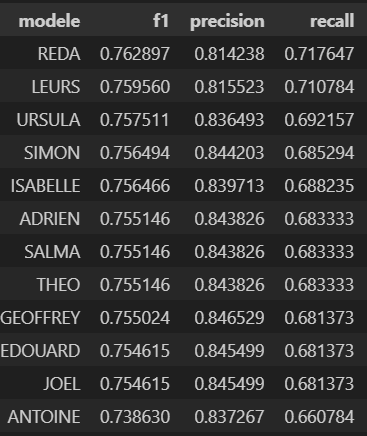

My model was the second best performing model, although it is worth mentioning that the differences in score are so small that the model may as well be as good as the first and third ones. 